In [1]:
# Importing Libraries

import warnings
warnings.filterwarnings("ignore")

import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from datetime import timedelta
from sklearn.impute import SimpleImputer
from pandas_profiling import ProfileReport
from category_encoders import TargetEncoder
from sklearn.preprocessing import StandardScaler
from matplotlib.ticker import FormatStrFormatter

from lightgbm import LGBMClassifier, plot_importance
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

from sklearn.experimental import enable_halving_search_cv 
from sklearn.model_selection import train_test_split, HalvingGridSearchCV
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, accuracy_score, roc_curve

import sklearn.datasets
import sklearn.metrics
import optuna

In [44]:
# Load the train data, output the first 5 rows

df_train = pd.read_csv('data/train.csv')
df_train.head()

,msno,song_id,source_system_tab,source_screen_name,source_type,target
0,FGtllVqz18RPiwJj/edr2gV78zirAiY/9SmYvia+kCg=,BBzumQNXUHKdEBOB7mAJuzok+IJA1c2Ryg/yzTF6tik=,explore,Explore,online-playlist,1
1,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,bhp/MpSNoqoxOIB+/l8WPqu6jldth4DIpCm3ayXnJqM=,my library,Local playlist more,local-playlist,1
2,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,JNWfrrC7zNN7BdMpsISKa4Mw+xVJYNnxXh3/Epw7QgY=,my library,Local playlist more,local-playlist,1
3,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,2A87tzfnJTSWqD7gIZHisolhe4DMdzkbd6LzO1KHjNs=,my library,Local playlist more,local-playlist,1
4,FGtllVqz18RPiwJj/edr2gV78zirAiY/9SmYvia+kCg=,3qm6XTZ6MOCU11x8FIVbAGH5l5uMkT3/ZalWG1oo2Gc=,explore,Explore,online-playlist,1


In [45]:
# Check the dataset size 

df_train.shape

(7377418, 6)

In [46]:
# Load the songs dataset, output the first 5 rows

df_songs = pd.read_csv('data/songs.csv')
df_songs.head()

,song_id,song_length,genre_ids,artist_name,composer,lyricist,language
0,CXoTN1eb7AI+DntdU1vbcwGRV4SCIDxZu+YD8JP8r4E=,247640,465,張信哲 (Jeff Chang),董貞,何啟弘,3.0
1,o0kFgae9QtnYgRkVPqLJwa05zIhRlUjfF7O1tDw0ZDU=,197328,444,BLACKPINK,TEDDY| FUTURE BOUNCE| Bekuh BOOM,TEDDY,31.0
2,DwVvVurfpuz+XPuFvucclVQEyPqcpUkHR0ne1RQzPs0=,231781,465,SUPER JUNIOR,NaN,NaN,31.0
3,dKMBWoZyScdxSkihKG+Vf47nc18N9q4m58+b4e7dSSE=,273554,465,S.H.E,湯小康,徐世珍,3.0
4,W3bqWd3T+VeHFzHAUfARgW9AvVRaF4N5Yzm4Mr6Eo/o=,140329,726,貴族精選,Traditional,Traditional,52.0


In [47]:
# Also check the dataset size

df_songs.shape

(2296320, 7)

In [48]:
# Merge datasets by the song_id column

df_full = pd.merge(left=df_train, right=df_songs, on='song_id', how='left') 
df_full.head(3)

,msno,song_id,source_system_tab,source_screen_name,source_type,target,song_length,genre_ids,artist_name,composer,lyricist,language
0,FGtllVqz18RPiwJj/edr2gV78zirAiY/9SmYvia+kCg=,BBzumQNXUHKdEBOB7mAJuzok+IJA1c2Ryg/yzTF6tik=,explore,Explore,online-playlist,1,206471.0,359,Bastille,Dan Smith| Mark Crew,NaN,52.0
1,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,bhp/MpSNoqoxOIB+/l8WPqu6jldth4DIpCm3ayXnJqM=,my library,Local playlist more,local-playlist,1,284584.0,1259,Various Artists,NaN,NaN,52.0
2,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,JNWfrrC7zNN7BdMpsISKa4Mw+xVJYNnxXh3/Epw7QgY=,my library,Local playlist more,local-playlist,1,225396.0,1259,Nas,N. Jones、W. Adams、J. Lordan、D. Ingle,NaN,52.0


In [49]:
# Check the size of merged dataset

df_full.shape

(7377418, 12)

In [50]:
# Load the song_extra_info dataset, output the first 5 rows

df_songs_extra = pd.read_csv('data/song_extra_info.csv')
df_songs_extra.head()

,song_id,name,isrc
0,LP7pLJoJFBvyuUwvu+oLzjT+bI+UeBPURCecJsX1jjs=,我們,TWUM71200043
1,ClazTFnk6r0Bnuie44bocdNMM3rdlrq0bCGAsGUWcHE=,Let Me Love You,QMZSY1600015
2,u2ja/bZE3zhCGxvbbOB3zOoUjx27u40cf5g09UXMoKQ=,原諒我,TWA530887303
3,92Fqsy0+p6+RHe2EoLKjHahORHR1Kq1TBJoClW9v+Ts=,Classic,USSM11301446
4,0QFmz/+rJy1Q56C1DuYqT9hKKqi5TUqx0sN0IwvoHrw=,愛投羅網,TWA471306001


In [51]:
# Merge song_extra_info datasets with previously merged dataset by the song_id column

df_full = pd.merge(left=df_full, right=df_songs_extra, on='song_id', how='left') 
df_full.head(3)

,msno,song_id,source_system_tab,source_screen_name,source_type,target,song_length,genre_ids,artist_name,composer,lyricist,language,name,isrc
0,FGtllVqz18RPiwJj/edr2gV78zirAiY/9SmYvia+kCg=,BBzumQNXUHKdEBOB7mAJuzok+IJA1c2Ryg/yzTF6tik=,explore,Explore,online-playlist,1,206471.0,359,Bastille,Dan Smith| Mark Crew,NaN,52.0,Good Grief,GBUM71602854
1,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,bhp/MpSNoqoxOIB+/l8WPqu6jldth4DIpCm3ayXnJqM=,my library,Local playlist more,local-playlist,1,284584.0,1259,Various Artists,NaN,NaN,52.0,Lords of Cardboard,US3C69910183
2,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,JNWfrrC7zNN7BdMpsISKa4Mw+xVJYNnxXh3/Epw7QgY=,my library,Local playlist more,local-playlist,1,225396.0,1259,Nas,N. Jones、W. Adams、J. Lordan、D. Ingle,NaN,52.0,Hip Hop Is Dead(Album Version (Edited)),USUM70618761


In [52]:
# Check the new size of merged dataset

df_full.shape

(7377418, 14)

In [53]:
# Load the members dataset, output the first 5 rows

df_members = pd.read_csv('data/members.csv')
df_members.head()

,msno,city,bd,gender,registered_via,registration_init_time,expiration_date
0,XQxgAYj3klVKjR3oxPPXYYFp4soD4TuBghkhMTD4oTw=,1,0,NaN,7,20110820,20170920
1,UizsfmJb9mV54qE9hCYyU07Va97c0lCRLEQX3ae+ztM=,1,0,NaN,7,20150628,20170622
2,D8nEhsIOBSoE6VthTaqDX8U6lqjJ7dLdr72mOyLya2A=,1,0,NaN,4,20160411,20170712
3,mCuD+tZ1hERA/o5GPqk38e041J8ZsBaLcu7nGoIIvhI=,1,0,NaN,9,20150906,20150907
4,q4HRBfVSssAFS9iRfxWrohxuk9kCYMKjHOEagUMV6rQ=,1,0,NaN,4,20170126,20170613


In [54]:
# Also check the dataset size

df_members.shape

(34403, 7)

In [55]:
# Also merge members datasets with previously merged dataset by the msno column

df_full = pd.merge(left=df_full, right=df_members, on='msno', how='left') 
df_full.head(3)

,msno,song_id,source_system_tab,source_screen_name,source_type,target,song_length,genre_ids,artist_name,composer,lyricist,language,name,isrc,city,bd,gender,registered_via,registration_init_time,expiration_date
0,FGtllVqz18RPiwJj/edr2gV78zirAiY/9SmYvia+kCg=,BBzumQNXUHKdEBOB7mAJuzok+IJA1c2Ryg/yzTF6tik=,explore,Explore,online-playlist,1,206471.0,359,Bastille,Dan Smith| Mark Crew,NaN,52.0,Good Grief,GBUM71602854,1,0,NaN,7,20120102,20171005
1,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,bhp/MpSNoqoxOIB+/l8WPqu6jldth4DIpCm3ayXnJqM=,my library,Local playlist more,local-playlist,1,284584.0,1259,Various Artists,NaN,NaN,52.0,Lords of Cardboard,US3C69910183,13,24,female,9,20110525,20170911
2,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,JNWfrrC7zNN7BdMpsISKa4Mw+xVJYNnxXh3/Epw7QgY=,my library,Local playlist more,local-playlist,1,225396.0,1259,Nas,N. Jones、W. Adams、J. Lordan、D. Ingle,NaN,52.0,Hip Hop Is Dead(Album Version (Edited)),USUM70618761,13,24,female,9,20110525,20170911


In [56]:
# Check the finally dataset size

df_full.shape

(7377418, 20)

In [16]:
# Use one of the AutoEDA tool - Pandas Profile Report from pandas_profiling libruary
# Function report output

profile = ProfileReport(df_full, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [57]:
# Determining the number of completely filled objects, the percentage and the number of missing values in features:
# We will need this several times for EDA, so I will create two functions for this purpose

def print_useful_rows_info(df):
    print('Number of completely filled objects from the entire sample:', len(df.dropna()))
    print('Percent of completely filled objects from the entire sample:', round(len(df.dropna()) / len(df) * 100, 2))
    
def missing_values(df):
    n = 0
    missing_values = ((df.isna().sum() / len(df)) * 100).sort_values(ascending=False)
    for i in range(0, len(missing_values)):
        if missing_values[i] > 0:
            print(missing_values.index[i], '-', df.loc[:, missing_values.index[i]].isna().sum())
            n += 1
        if n == 0 and i == len(missing_values) - 1:
            print(n)
            
print_useful_rows_info(df_full)
perc_missing_values = ((df_full.isna().sum() / len(df_full)) * 100).sort_values(ascending=False)
print(f'Percent of missing values:\n' + f'{perc_missing_values}')

Number of completely filled objects from the entire sample: 2199255
Percent of completely filled objects from the entire sample: 29.81
Percent of missing values:
lyricist                  43.088219
gender                    40.142486
composer                  22.713990
isrc                       7.832795
source_screen_name         5.622618
genre_ids                  1.605643
source_system_tab          0.336825
source_type                0.291959
name                       0.019749
language                   0.002033
song_length                0.001545
artist_name                0.001545
bd                         0.000000
registration_init_time     0.000000
registered_via             0.000000
msno                       0.000000
city                       0.000000
song_id                    0.000000
target                     0.000000
expiration_date            0.000000
dtype: float64


In [58]:
print('Number of missing values in columns:')
missing_values(df_full)

Number of missing values in columns:
lyricist - 3178798
gender - 2961479
composer - 1675706
isrc - 577858
source_screen_name - 414804
genre_ids - 118455
source_system_tab - 24849
source_type - 21539
name - 1457
language - 150
song_length - 114
artist_name - 114


In [59]:
# Leave only filled rows for features with gaps less than 1%

df_full = df_full[(df_full.artist_name.notna()) & (df_full.source_system_tab.notna()) & (df_full.source_type.notna()) &
                 (df_full.name.notna()) & (df_full.language.notna())]

In [60]:
# Check the number of missing values in columns

print('Number of missing values in columns:')
missing_values(df_full)

Number of missing values in columns:
lyricist - 3166649
gender - 2950908
composer - 1669225
isrc - 574302
source_screen_name - 389837
genre_ids - 117911


In [61]:
# Fill the gaps in the columns with the new value 'unknown'

imp_const_unknown = SimpleImputer(strategy='constant', fill_value='unknown')
unk_cols = ['lyricist', 'gender', 'composer', 'isrc', 'source_screen_name', 'genre_ids']
df_full[unk_cols] = imp_const_unknown.fit_transform(df_full[unk_cols])

In [62]:
# Check the number of missing values in columns

print('Number of missing values in columns:')
missing_values(df_full)

Number of missing values in columns:
0


In [63]:
# Convert the data type of some numeric features to 'str', since they are actually categorical. For the model, for example, 
# 20 > 15, but in fact it cannot be said that one city is better than another by 25%. This can degrade the predictive ability 
# of the model.

df_full.genre_ids = df_full.genre_ids.astype('str')
df_full.registered_via = df_full.registered_via.astype('str')
df_full.city = df_full.city.astype('str')
df_full.language = df_full.language.astype('str')

In [64]:
# Create a function to calculate the interquartile range

def calculate_outliers(data):
    q25 = data.quantile(0.25)
    q75 = data.quantile(0.75)
    iqr = q75 - q25
    boundaries = (q25 - 1.5 * iqr, q75 + 1.5 * iqr)
    return boundaries

Bottom border -  -43.5 
Upper border -  72.5 
Number of outliers -  9484


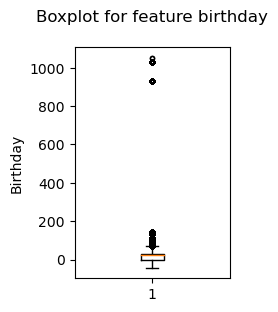

In [65]:
# Define outliers with a function in feature 'birthday'(or 'bd') and vizualizate it

boundaries = calculate_outliers(df_full['bd'])
outlier = (df_full['bd'] < boundaries[0]) | (df_full['bd'] > boundaries[1])
print('Bottom border - ', boundaries[0], '\nUpper border - ', boundaries[1], '\nNumber of outliers - ', outlier.sum())
    
plt.figure(figsize=(2, 3))
plt.boxplot(df_full['bd'][df_full['bd'].notna()], sym='.')
plt.ylabel('Birthday') 
plt.title('Boxplot for feature birthday' + '\n')
plt.show();

In [66]:
# The values 150, 900, 1000 years are clearly outliers. Removing them from the dataset

df_full = df_full[df_full.bd < boundaries[1]]

In [67]:
# Create a function to plot the distribution of feature values

def distribution_graph(data, feat, n_bins):
    fig, ax = plt.subplots(figsize=(5, 3))

    ax.hist(data.values, bins=n_bins, color=['blue'])
    ax.set_xlabel('Feature value ' + feat)
    ax.set_ylabel('Frequency')
    ax.set_title('Feature distribution ' + feat)
    fig.autofmt_xdate(rotation=45)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.0f'));

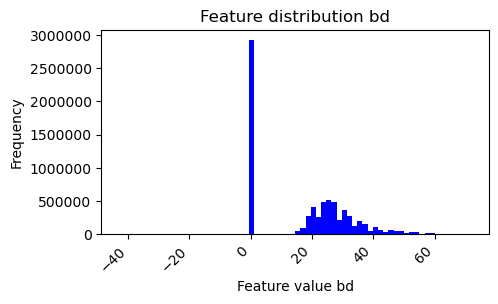

In [68]:
# Displaying a distribution plot for feature 'bd'

distribution_graph(df_full.bd, 'bd', df_full['bd'].nunique())

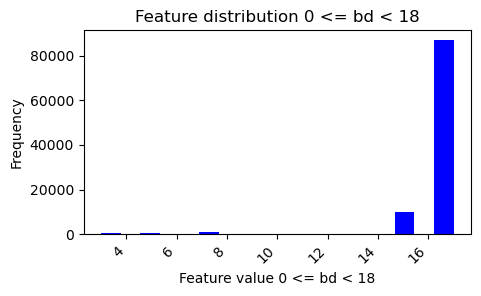

In [69]:
#  ... and separately for age before 18

distribution_graph(df_full.bd[(df_full.bd < 18) & df_full.bd[(df_full.bd >= 0)]], '0 <= bd < 18', 18)

In [70]:
# It is unlikely that children 4, 6 or 8 years old could create and use an account. In any case, there are not many such values.
# Also remove them from the dataset

df_full = df_full[df_full.bd >= 15]

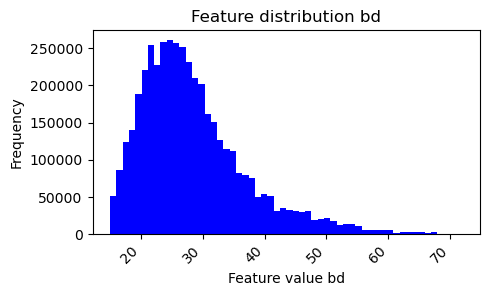

In [71]:
distribution_graph(df_full.bd, 'bd', df_full['bd'].nunique())

In [72]:
# Convert the registration_init_time and expiration date attributes to datetime and generate new attributes: day of the month, 
# day of the week, month, year of registration start and end, and its duration in days

df_full.registration_init_time = df_full.registration_init_time.astype('str')
df_full.registration_init_time = df_full.registration_init_time.apply(lambda x: x[:4] + '-' + x[4:6] + '-' + x[6:8])
df_full.registration_init_time = pd.to_datetime(df_full.registration_init_time)
df_full['r_month'] = df_full.registration_init_time.dt.month
df_full['r_dayofweek'] = df_full.registration_init_time.dt.weekday
df_full['r_year'] = df_full.registration_init_time.dt.year
df_full['r_day'] = df_full.registration_init_time.dt.day

df_full.expiration_date = df_full.expiration_date.astype('str')
df_full.expiration_date = df_full.expiration_date.apply(lambda x: x[:4] + '-' + x[4:6] + '-' + x[6:8])
df_full.expiration_date = pd.to_datetime(df_full.expiration_date)
df_full['e_month'] = df_full.expiration_date.dt.month
df_full['e_dayofweek'] = df_full.expiration_date.dt.weekday
df_full['e_year'] = df_full.expiration_date.dt.year
df_full['e_day'] = df_full.expiration_date.dt.day

df_full['re_delta'] = df_full.apply(lambda x: (x.expiration_date - x.registration_init_time).days, axis=1)

df_full = df_full.drop(columns=['expiration_date', 'registration_init_time'])
df_full.head()

,msno,song_id,source_system_tab,source_screen_name,source_type,target,song_length,genre_ids,artist_name,composer,...,registered_via,r_month,r_dayofweek,r_year,r_day,e_month,e_dayofweek,e_year,e_day,re_delta
1,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,bhp/MpSNoqoxOIB+/l8WPqu6jldth4DIpCm3ayXnJqM=,my library,Local playlist more,local-playlist,1,284584.0,1259,Various Artists,unknown,...,9,5,2,2011,25,9,0,2017,11,2301
2,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,JNWfrrC7zNN7BdMpsISKa4Mw+xVJYNnxXh3/Epw7QgY=,my library,Local playlist more,local-playlist,1,225396.0,1259,Nas,N. Jones、W. Adams、J. Lordan、D. Ingle,...,9,5,2,2011,25,9,0,2017,11,2301
3,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,2A87tzfnJTSWqD7gIZHisolhe4DMdzkbd6LzO1KHjNs=,my library,Local playlist more,local-playlist,1,255512.0,1019,Soundway,Kwadwo Donkoh,...,9,5,2,2011,25,9,0,2017,11,2301
6,Xumu+NIjS6QYVxDS4/t3SawvJ7viT9hPKXmf0RtLNx8=,VkILU0H1h3NMmk9MQrXouNudGk5n8Ls5cqRRuBxeTh4=,my library,Local playlist more,local-playlist,1,229982.0,465,BIGBANG TAEYANG,TEDDY| DEE.P| Rebecca Johnson,...,9,5,2,2011,25,9,0,2017,11,2301
8,uHqAtShXTRXju5GE8ri3ITsVFepPf8jUoCF7ffNOuqE=,/bU6IRSK+YNlNbaTkxo7bhsb2EDLPrnksdX3ggcZNhI=,my library,Local playlist more,local-library,1,278964.0,2022,OneRepublic,Ryan Tedder,...,9,11,0,2011,7,3,6,2018,4,2309


In [73]:
# Transform categorical variables with TargetEncoder

data = ['msno', 'song_id', 'source_type', 'genre_ids', 'artist_name', 'composer', 
        'lyricist', 'name', 'city', 'gender', 'registered_via', 'language']
encoder = TargetEncoder(smoothing=0.5)
for elem in data:
     df_full[elem+'_encoding'] = encoder.fit_transform(df_full[elem], df_full['target'])

In [74]:
# Normalization of numeric variables with StandardScaler

quant_list = ['song_length', 'bd', 'r_month', 'r_dayofweek', 'r_day', 'e_month', 'e_dayofweek', 'e_year', 'e_day', 
              're_delta']
data_quant = df_full[quant_list]
std_scaler = StandardScaler()
std_scaler.fit(data_quant)
std_scaled = std_scaler.transform(data_quant)
std_quant_list = ['std_scaled_' + elem for elem in quant_list]
df_full[std_quant_list] = std_scaled

In [75]:
# Remove non-informative columns and original features before transformations

columns_for_drop = ['msno', 'song_id', 'source_system_tab', 'source_screen_name', 'source_type', 'genre_ids', 'artist_name', 
                    'composer', 'lyricist', 'name', 'isrc', 'city', 'gender', 'registered_via', 'language', 'song_length', 
                    'bd', 'r_year', 'r_month', 'r_dayofweek', 'r_day', 'e_month', 'e_dayofweek', 'e_year', 'e_day', 're_delta']
df_prepared = df_full.drop(columns=columns_for_drop)
df_prepared.head()

,target,msno_encoding,song_id_encoding,source_type_encoding,genre_ids_encoding,artist_name_encoding,composer_encoding,lyricist_encoding,name_encoding,city_encoding,...,std_scaled_song_length,std_scaled_bd,std_scaled_r_month,std_scaled_r_dayofweek,std_scaled_r_day,std_scaled_e_month,std_scaled_e_dayofweek,std_scaled_e_year,std_scaled_e_day,std_scaled_re_delta
1,1,0.742765,0.510108,0.652900,0.469335,0.518189,0.458339,0.472955,0.510108,0.523181,...,0.603914,-0.554503,-0.491766,-0.577704,1.039060,0.288616,-1.622330,-0.309682,-0.529832,0.259965
2,1,0.742765,0.500025,0.652900,0.469335,0.207254,0.500025,0.472955,0.500025,0.523181,...,-0.305873,-0.554503,-0.491766,-0.577704,1.039060,0.288616,-1.622330,-0.309682,-0.529832,0.259965
3,1,0.742765,0.510108,0.652900,0.136364,0.510108,0.510108,0.472955,0.510108,0.523181,...,0.157044,-0.554503,-0.491766,-0.577704,1.039060,0.288616,-1.622330,-0.309682,-0.529832,0.259965
6,1,0.742765,0.676522,0.652900,0.512657,0.589038,0.676522,0.672913,0.676522,0.523181,...,-0.235381,-0.554503,-0.491766,-0.577704,1.039060,0.288616,-1.622330,-0.309682,-0.529832,0.259965
8,1,0.829755,0.500000,0.624022,0.425681,0.516303,0.563384,0.472955,0.500000,0.511501,...,0.517529,-0.319571,1.177283,-1.568298,-1.011694,-2.009712,1.384722,2.091108,-1.294739,0.266726


In [76]:
# Check and visualizate the correlation of final features

df_prepared.corr()

,target,msno_encoding,song_id_encoding,source_type_encoding,genre_ids_encoding,artist_name_encoding,composer_encoding,lyricist_encoding,name_encoding,city_encoding,...,std_scaled_song_length,std_scaled_bd,std_scaled_r_month,std_scaled_r_dayofweek,std_scaled_r_day,std_scaled_e_month,std_scaled_e_dayofweek,std_scaled_e_year,std_scaled_e_day,std_scaled_re_delta
target,1.000000,0.356631,0.293277,0.259735,0.088143,0.204946,0.211019,0.175090,0.270938,0.025271,...,-0.001034,-0.040594,-0.000196,0.005466,-0.004038,0.007338,0.004298,0.021251,0.001275,-0.011780
msno_encoding,0.356631,1.000000,0.137045,0.283455,0.062003,0.127356,0.105320,0.079438,0.129698,0.070842,...,-0.002445,-0.113816,-0.000532,0.015331,-0.011338,0.020562,0.012044,0.059382,0.003570,-0.033109
song_id_encoding,0.293277,0.137045,1.000000,0.210267,0.265794,0.592772,0.668653,0.572684,0.890699,0.008251,...,0.001815,-0.082129,-0.001454,0.009625,0.000607,-0.001497,0.002504,-0.011323,-0.006128,-0.019418
source_type_encoding,0.259735,0.283455,0.210267,1.000000,0.064929,0.185024,0.139547,0.098069,0.192822,0.039125,...,0.000223,-0.086762,-0.001371,0.013235,-0.004131,-0.000489,0.010605,0.038528,-0.006780,0.017594
genre_ids_encoding,0.088143,0.062003,0.265794,0.064929,1.000000,0.364939,0.315741,0.264173,0.285007,0.000333,...,-0.004083,-0.075115,-0.000848,0.008952,0.000715,0.003287,0.003040,-0.013388,-0.003359,-0.016602
artist_name_encoding,0.204946,0.127356,0.592772,0.185024,0.364939,1.000000,0.613448,0.525225,0.604395,0.007806,...,-0.032592,-0.103038,-0.003331,0.011142,0.000357,-0.003247,0.002196,-0.010413,-0.007634,-0.023960
composer_encoding,0.211019,0.105320,0.668653,0.139547,0.315741,0.613448,1.000000,0.714011,0.667461,0.004834,...,-0.002537,-0.083302,-0.002120,0.008671,0.001604,-0.001438,0.000608,-0.014596,-0.006833,-0.023801
lyricist_encoding,0.175090,0.079438,0.572684,0.098069,0.264173,0.525225,0.714011,1.000000,0.578455,0.002247,...,0.019900,-0.063621,-0.001016,0.004638,0.001400,-0.000421,-0.000785,-0.014204,-0.005406,-0.019318
name_encoding,0.270938,0.129698,0.890699,0.192822,0.285007,0.604395,0.667461,0.578455,1.000000,0.006617,...,0.007071,-0.086264,-0.001845,0.009602,0.000584,-0.001027,0.002559,-0.013372,-0.006626,-0.021783
city_encoding,0.025271,0.070842,0.008251,0.039125,0.000333,0.007806,0.004834,0.002247,0.006617,1.000000,...,-0.000475,0.025685,-0.019260,0.000290,-0.020398,0.008599,-0.001333,0.037273,-0.008893,0.072087


<AxesSubplot:>

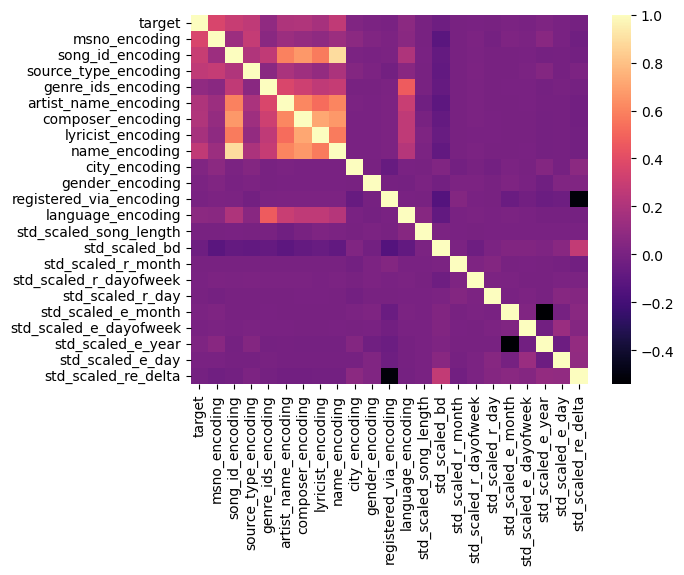

In [88]:
sns.heatmap(df_prepared.corr(), cmap='magma')

In [89]:
# Split into training and test datasets

x = df_prepared.drop(['target'], axis=1)
y = df_prepared['target']

train_x, test_x, train_y, test_y = train_test_split(x, y, test_size=0.3, random_state=42)

In [ ]:
# Using the optuna library, we will select the optimal hyperparameters for several models: LGBMClassifier, 
# RandomForestClassifier and XGBClassifier

In [15]:
seed = 42
np.random.seed(seed)

def objective(trial,data=x,target=y):
    
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.3,random_state=42)
    param = { 'random_state': 42,
              'n_jobs': 5,
              "n_estimators": trial.suggest_int("n_estimators", 100, 1000), 
              "max_features": trial.suggest_categorical("max_features", ['sqrt', 'log2', None]), 
              "max_depth": trial.suggest_int("max_depth", 1, 1000), 
              "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
              "min_samples_leaf": trial.suggest_int("min_samples_split", 1, 20),
              "criterion": trial.suggest_categorical("criterion", ['gini', 'entropy'])
    }
    model = RandomForestClassifier(**param)  
    
    model.fit(train_x,train_y)
    
    preds = model.predict_proba(test_x)[:, 1]
    
    roc_auc = roc_auc_score(test_y, preds)
    
    return roc_auc

In [16]:
study = optuna.create_study(
    direction="maximize",
    sampler=optuna.samplers.TPESampler(seed=SEED),
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=10),
)
study.optimize(objective, n_trials=100, timeout=600)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2022-12-07 21:06:08,950] A new study created in memory with name: no-name-e151e4f3-c2bf-4473-a0b6-3a0bb5f06b64
[I 2022-12-07 21:06:39,354] Trial 0 finished with value: 0.8844896463116627 and parameters: {'n_estimators': 437, 'max_features': 'sqrt', 'max_depth': 157, 'min_samples_split': 4, 'criterion': 'entropy'}. Best is trial 0 with value: 0.8844896463116627.
[I 2022-12-07 21:09:50,155] Trial 1 finished with value: 0.8884460281520048 and parameters: {'n_estimators': 641, 'max_features': None, 'max_depth': 833, 'min_samples_split': 6, 'criterion': 'entropy'}. Best is trial 1 with value: 0.8884460281520048.
[I 2022-12-07 21:10:17,364] Trial 2 finished with value: 0.8843988075165348 and parameters: {'n_estimators': 374, 'max_features': 'sqrt', 'max_depth': 612, 'min_samples_split': 4, 'criterion': 'entropy'}. Best is trial 1 with value: 0.8884460281520048.
[I 2022-12-07 21:10:52,006] Trial 3 finished with value: 0.8858143189929732 and parameters: {'n_estimators': 510, 'max_features':

Number of finished trials: 11
Best trial: {'n_estimators': 641, 'max_features': None, 'max_depth': 833, 'min_samples_split': 6, 'criterion': 'entropy'}


In [6]:
def objective(trial,data=x,target=y):
    
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.3,random_state=42)
    param = {
             'metric': 'roc_auc', 
             'random_state': 42,
             'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
             'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-2, 1e2),
             'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-2, 1e2),
             'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.6,0.8,1.0]),
             'subsample': trial.suggest_categorical('subsample', [0.6,0.8,1.0]),
             'boosting_type': trial.suggest_categorical('boosting_type', ['gbdt', 'dart', 'goss']),
             'learning_rate': trial.suggest_categorical('learning_rate', [0.005,0.01,0.001,0.05]),
             'max_depth': trial.suggest_categorical('max_depth', [10,20, 50, 100]),
             'num_leaves' : trial.suggest_int('num_leaves', 1, 1000),
             'min_child_samples': trial.suggest_int('min_child_samples', 1, 300)
    }
    model = LGBMClassifier(**param)  
    
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)],verbose=1)
    
    preds = model.predict_proba(test_x)[:, 1]
    
    roc_auc = roc_auc_score(test_y, preds)
    
    return roc_auc

In [7]:
study = optuna.create_study(
    direction="maximize",
    sampler=optuna.samplers.TPESampler(seed=SEED),
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=10),
)
study.optimize(objective, n_trials=100, timeout=600)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2022-12-08 12:12:00,754] A new study created in memory with name: no-name-326b16d3-991d-4fe9-9977-a3404e35f8ae
[I 2022-12-08 12:12:09,583] Trial 0 finished with value: 0.8221960118543925 and parameters: {'n_estimators': 437, 'reg_alpha': 63.512210106407046, 'reg_lambda': 8.471801418819979, 'colsample_bytree': 0.6, 'subsample': 0.8, 'boosting_type': 'goss', 'learning_rate': 0.005, 'max_depth': 20, 'num_leaves': 612, 'min_child_samples': 42}. Best is trial 0 with value: 0.8221960118543925.
[I 2022-12-08 12:12:14,408] Trial 1 finished with value: 0.8188403349949094 and parameters: {'n_estimators': 363, 'reg_alpha': 0.2920433847181412, 'reg_lambda': 0.6672367170464207, 'colsample_bytree': 0.6, 'subsample': 1.0, 'boosting_type': 'goss', 'learning_rate': 0.005, 'max_depth': 10, 'num_leaves': 35, 'min_child_samples': 273}. Best is trial 0 with value: 0.8221960118543925.
[I 2022-12-08 12:12:24,189] Trial 2 finished with value: 0.869780423103804 and parameters: {'n_estimators': 333, 'reg_alp

Number of finished trials: 20
Best trial: {'n_estimators': 837, 'reg_alpha': 0.025436139710502317, 'reg_lambda': 1.8398307458079184, 'colsample_bytree': 0.8, 'subsample': 0.8, 'boosting_type': 'gbdt', 'learning_rate': 0.05, 'max_depth': 50, 'num_leaves': 762, 'min_child_samples': 1}


In [36]:
def objective(trial,data=x,target=y):
    
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.3,random_state=42)
    param = {
             'random_state': 42,
             'min_child_weight': trial.suggest_int('min_child_weight', 1, 30),
             'gamma': trial.suggest_int('gamma', 1, 1000),
             'subsample': trial.suggest_categorical('subsample', [0.4, 0.6, 0.8, 1.0]),
             'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.4, 0.6, 0.8, 1.0]),
             'max_depth': trial.suggest_categorical('max_depth', [10, 20, 50, 100]),
             'n_estimators': trial.suggest_int('n_estimators', 100, 10000),
             'learning_rate': trial.suggest_categorical('learning_rate', [0.1, 0.01, 0.05, 0.025, 0.001]),
             'tree_method': 'gpu_hist', 
             'gpu_id': 0
             
    }
    model = XGBClassifier(**param)  
    
    model.fit(train_x,train_y)
    
    preds = model.predict_proba(test_x)[:, 1]
    
    roc_auc = roc_auc_score(test_y, preds)
    
    return roc_auc

In [37]:
study = optuna.create_study(
    direction="maximize",
    sampler=optuna.samplers.TPESampler(seed=SEED),
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=10),
)
study.optimize(objective, n_trials=100, timeout=600)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2022-12-07 22:03:52,314] A new study created in memory with name: no-name-89ea5bed-3813-4a3c-a000-7a3df907c07c
[I 2022-12-07 22:03:58,460] Trial 0 finished with value: 0.8608704967563169 and parameters: {'min_child_weight': 14, 'gamma': 10, 'subsample': 0.6, 'colsample_bytree': 1.0, 'max_depth': 1000, 'learning_rate': 0.1}. Best is trial 0 with value: 0.8608704967563169.
[I 2022-12-07 22:05:17,997] Trial 1 finished with value: 0.8742093995564378 and parameters: {'min_child_weight': 15, 'gamma': 5, 'subsample': 0.8, 'colsample_bytree': 1.0, 'max_depth': 100, 'learning_rate': 0.001}. Best is trial 1 with value: 0.8742093995564378.
[I 2022-12-07 22:06:10,427] Trial 2 finished with value: 0.8634065966953814 and parameters: {'min_child_weight': 20, 'gamma': 9, 'subsample': 1.0, 'colsample_bytree': 1.0, 'max_depth': 200, 'learning_rate': 0.001}. Best is trial 1 with value: 0.8742093995564378.
[I 2022-12-07 22:06:54,590] Trial 3 finished with value: 0.8622292064585645 and parameters: {'min

Number of finished trials: 15
Best trial: {'min_child_weight': 18, 'gamma': 1, 'subsample': 0.8, 'colsample_bytree': 1.0, 'max_depth': 100, 'learning_rate': 0.01}


In [3]:
# Training models with optimal parameters

rf_clf = RandomForestClassifier(criterion='entropy', n_estimators=641, n_jobs=6, max_depth=833, min_samples_split=6)
XGB = XGBClassifier(colsample_bytree=1.0, gamma=1, gpu_id=0, learning_rate=0.01, max_depth=100, 
                    min_child_weight=18, n_estimators=3373, subsample=0.8, tree_method='gpu_hist')
LGBM = LGBMClassifier(boosting_type='gbdt', n_estimators=837, min_child_samples=1, learning_rate=0.05, 
                      reg_alpha=0.0254, reg_lambda=1.8398, colsample_bytree=0.8, subsample=0.8, max_depth=50, num_leaves=762)

In [4]:
result_table = pd.DataFrame(columns=['classifiers', 'fpr','tpr','auc'])

# Train the models and record the results
for model in [LGBM, rf_clf, XGB]:
    train_model = model.fit(train_x, train_y)
    y_proba = train_model.predict_proba(test_x)[:,1]
    y_pred = train_model.predict(test_x)
    
    accuracy = accuracy_score(test_y, y_pred)
    roc_auc = roc_auc_score(test_y, y_proba)
    print('Metrics values on test sample:')
    print(f'Model {(str(model).split("(")[0])}:\nROC_AUC - {round(roc_auc, 2)}\
          \nAccuracy - {round(accuracy, 2)}\n{"-" * 40}') 
    
    fpr, tpr, _ = roc_curve(test_y,  y_proba)
    
    result_table = result_table.append({'classifiers':model.__class__.__name__,
                                        'fpr':fpr, 
                                        'tpr':tpr, 
                                        'auc':roc_auc}, ignore_index=True)

# Set name of the classifiers as index labels
result_table.set_index('classifiers', inplace=True)

Metrics values on test sample:
Model LGBMClassifier:
ROC_AUC - 0.82          
Accuracy - 0.74
----------------------------------------
Metrics values on test sample:
Model RandomForestClassifier:
ROC_AUC - 0.82          
Accuracy - 0.74
----------------------------------------
Metrics values on test sample:
Model XGBClassifier:
ROC_AUC - 0.83          
Accuracy - 0.75
----------------------------------------


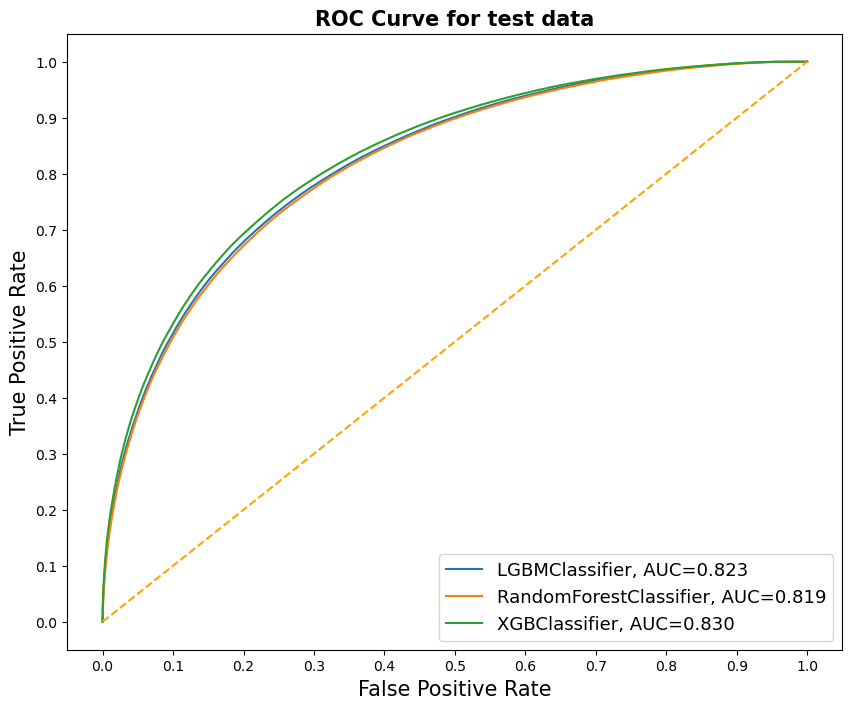

In [5]:
# Plotting ROC_AUC for models on test set

fig = plt.figure(figsize=(10,8))

for i in result_table.index:
    plt.plot(result_table.loc[i]['fpr'], 
             result_table.loc[i]['tpr'], 
             label="{}, AUC={:.3f}".format(i, result_table.loc[i]['auc']))
    
plt.plot([0,1], [0,1], color='orange', linestyle='--')

plt.xticks(np.arange(0.0, 1.1, step=0.1))
plt.xlabel("False Positive Rate", fontsize=15)

plt.yticks(np.arange(0.0, 1.1, step=0.1))
plt.ylabel("True Positive Rate", fontsize=15)

plt.title('ROC Curve for test data', fontweight='bold', fontsize=15)
plt.legend(prop={'size':13}, loc='lower right')

plt.show();

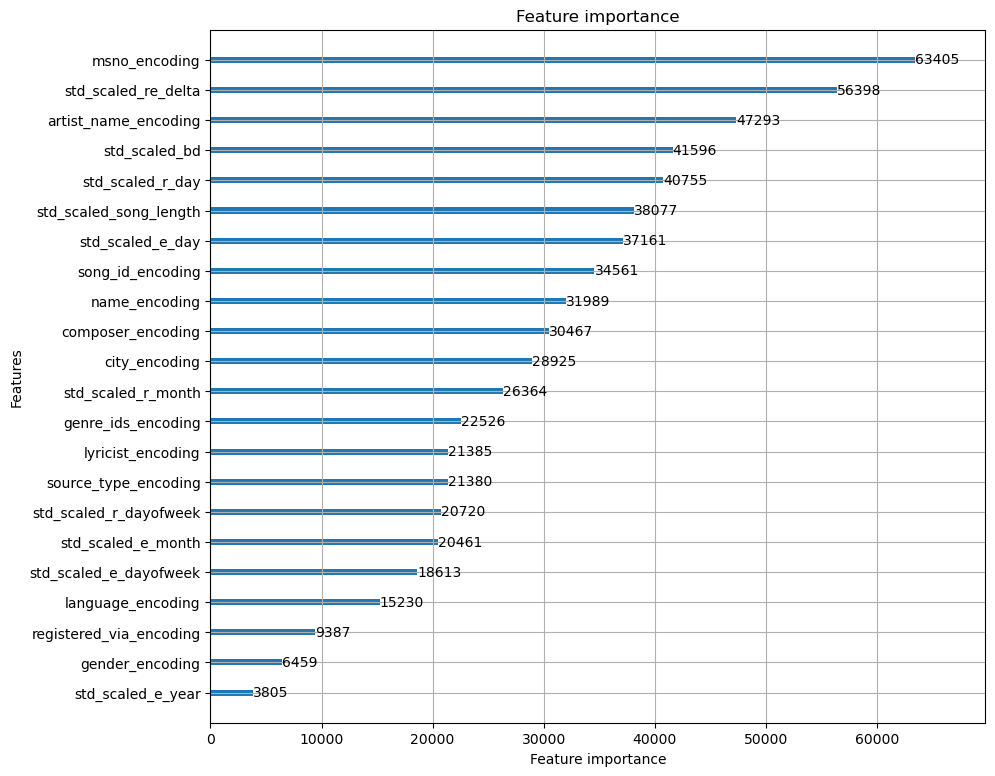

In [8]:
# feature_importances for a LGBMClassifier model

plot_importance(LGBM, figsize=(10, 9));

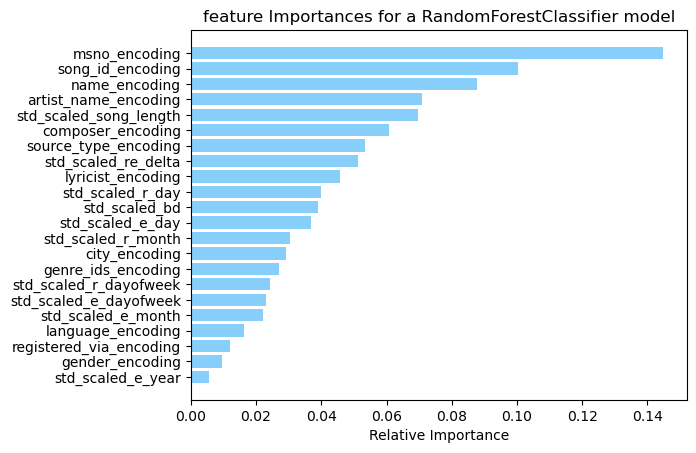

In [9]:
# feature_importances for a RandomForestClassifier model

feat_dict = dict(zip(rf_clf.feature_names_in_, rf_clf.feature_importances_))
sorted_feat_dict = {}
sorted_keys = sorted(feat_dict, key=feat_dict.get)  # [1, 3, 2]

for w in sorted_keys:
    sorted_feat_dict[w] = feat_dict[w]

plt.title('feature Importances for a RandomForestClassifier model')
plt.barh(list(sorted_feat_dict.keys()), list(sorted_feat_dict.values()), color='lightskyblue', align='center')
plt.yticks(list(sorted_feat_dict.keys()))
plt.xlabel('Relative Importance')
plt.show();

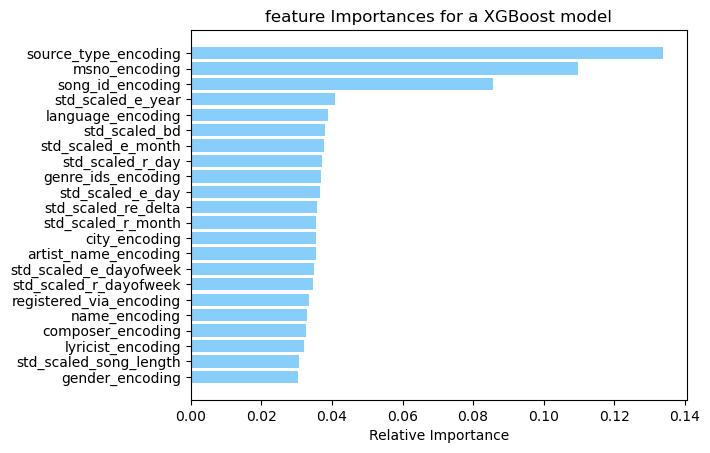

In [10]:
# feature_importances for a XGBoost model

feature_names = XGB.get_booster().feature_names

feat_dict = dict(zip(feature_names, XGB.feature_importances_))
sorted_feat_dict = {}
sorted_keys = sorted(feat_dict, key=feat_dict.get)  # [1, 3, 2]

for w in sorted_keys:
    sorted_feat_dict[w] = feat_dict[w]

plt.title('feature Importances for a XGBoost model')
plt.barh(list(sorted_feat_dict.keys()), list(sorted_feat_dict.values()), color='lightskyblue', align='center')
plt.yticks(list(sorted_feat_dict.keys()))
plt.xlabel('Relative Importance')
plt.show();